In [108]:
!pip install gdown
!pip install matplotlib

  Using cached cycler-0.12.1-py3-none-any.whl.metadata (3.8 kB)
  Using cached pyparsing-3.2.5-py3-none-any.whl.metadata (5.0 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.1/8.1 MB 49.5 MB/s  0:00:00
Using cached cycler-0.12.1-py3-none-any.whl (8.3 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 38.9 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 27.3 MB/s  0:00:00
Using cached pyparsing-3.2.5-py3-none-any.whl (113 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7/7 [matplotlib]7 [matplotlib]


In [110]:
import gdown
import os
import pandas as pd
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt

# Downloading and Cleaning Data

In [66]:
# all the links to the google drive files for each year data (2014-2025)
links = {
    2014: 'https://drive.google.com/file/d/12syQsRH2QnKrQZTQQ6G5zyVeTG2pAYvu/view?usp=sharing',
    2015: 'https://drive.google.com/file/d/1qyckLuw0-hJM8XqFhlV9l1xAbr3H78T_/view?usp=sharing',
    2016: 'https://drive.google.com/file/d/1muyfpaIqk8_0BFkgLCWXDGNgWSXoPBwG/view?usp=sharing',
    2017: 'https://drive.google.com/file/d/11fx3nNjSYB0X8vKxLAbYOrS2Bu6avm9A/view?usp=sharing',
    2018: 'https://drive.google.com/file/d/1GsNetJQOMx0QJ6_FN8M1kwGvU_GPPcPZ/view?usp=sharing',
    2019: 'https://drive.google.com/file/d/11eKtScnZcpfZcD3w3UrD7nnpfLHvj9_t/view?usp=sharing',
    2020: 'https://drive.google.com/file/d/1dlSIczXShnv1vIfGNvBjgk-thMKA5j7d/view?usp=sharing',
    2021: 'https://drive.google.com/file/d/1fzwTTz77hcnYjOnO9ONeoPrkWCoOSecA/view?usp=sharing',
    2022: 'https://drive.google.com/file/d/1EHmptHyzY8owv0BAcNKtkQpMwfkURwRy/view?usp=sharing',
    2023: 'https://drive.google.com/file/d/1XXk2LO0CsNADBB1LRGOV5rUpyZdEZ8s2/view?usp=sharing',
    2024: 'https://drive.google.com/file/d/1IjIEhLc9n8eLKeY-yh_YigKVWbhgGBsN/view?usp=sharing',
    2025: 'https://drive.google.com/file/d/1v6LRphp2kYciU4SXp0PCjEMuev1bDejc/view?usp=sharing'
}

for year, url in links.items():
    output = f'data_{year}.csv'
    if not os.path.exists(output):
        gdown.download(url, output, quiet=False, fuzzy=True)
        print(f'Downloaded data for year {year} to {output}')
        continue
    print(f'In system: data for year {year} to {output}')

In system: data for year 2014 to data_2014.csv
In system: data for year 2015 to data_2015.csv
In system: data for year 2016 to data_2016.csv
In system: data for year 2017 to data_2017.csv
In system: data for year 2018 to data_2018.csv
In system: data for year 2019 to data_2019.csv
In system: data for year 2020 to data_2020.csv
In system: data for year 2021 to data_2021.csv
In system: data for year 2022 to data_2022.csv
In system: data for year 2023 to data_2023.csv
In system: data for year 2024 to data_2024.csv
In system: data for year 2025 to data_2025.csv


In [67]:
def load_data(year: int) -> pd.DataFrame:
    """
    Load the data for a given year.

    Parameters:
    year (int): The year of the data to load.

    Returns:
    pd.DataFrame: The loaded data as a pandas DataFrame.
    """
    df = pd.read_csv(f'data_{year}.csv')

    # check rows and columns
    assert df.shape[0] > 0, f"No rows found for year {year}"
    assert df.shape[1] > 0, f"No columns found for year {year}"  

    # check NAs in columns
    empty_cols = df.columns[df.isna().all()].tolist()
    assert len(empty_cols) == 0, f"All values are NA in columns {empty_cols} for year {year}"

    # check NAs in rows
    empty_rows = df.index[df.isna().all(axis=1)].tolist()
    assert len(empty_rows) == 0, f"All values are NA in rows {empty_rows} for year {year}"

    return df


In [68]:
pd.set_option('display.max_columns', None)

2014 Data

In [69]:
df_2014 = pd.read_csv('data_2014.csv')
df_2014.head()

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,TRLH3/33,complete,http://matchhistory.na.leagueoflegends.com/en/...,EU LCS,2014,Spring,0,2014-01-14 17:52:02,1,3.15,1,Blue,top,sOAZ,oe:player:e4e943fa882367a96fb2a365de4e28c,Fnatic,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Trundle,Riven,Kha'Zix,Yasuo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1924,1,3,0,13,21,5,0,0,0,0,1,1.0,0.0,0.0,0.6549,0.8108,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,12569,391.9647,0.170201,1094.8753,0.0,0,13,0.4054,0,0.0000,0,0,0.0,11499,7539,235.1040,0.190230,8920,NaN,NaN,209.0,209,0,0,0,6.5177,3080,3907,57,3086,3994,57,-6,-87,0,2,0,0,1,1,1,4837,6615,110,4788,7175,111,49,-560,-1,2,0,0,1,1,1,6958,9467,166,6572,10098,157,386,-631,9,3,0,0,1,2,1,8735.0,12111.0,188.0,8659.0,12623.0,206.0,76.0,-512.0,-18.0,3.0,4.0,0.0,1.0,2.0,2.0
1,TRLH3/33,complete,http://matchhistory.na.leagueoflegends.com/en/...,EU LCS,2014,Spring,0,2014-01-14 17:52:02,1,3.15,2,Blue,jng,Cyanide,oe:player:e4cd1e7b68ee6b595a6e4c7cd2c56d8,Fnatic,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Vi,Riven,Kha'Zix,Yasuo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1924,1,0,4,14,21,5,0,0,0,0,1,0.0,1.0,0.0,0.6549,0.8108,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,7067,220.3846,0.095697,611.9751,0.0,0,12,0.3742,0,0.0000,1,0,0.0,10113,6153,191.8815,0.155260,6780,NaN,NaN,115.0,24,91,83,8,3.5863,2335,2732,32,3437,4157,59,-1102,-1425,-27,0,2,2,2,0,0,3869,6036,59,4976,6739,95,-1107,-703,-36,0,2,2,2,0,0,5300,8598,85,6504,8885,115,-1204,-287,-30,0,3,3,2,1,0,7122.0,11230.0,98.0,8010.0,10879.0,140.0,-888.0,351.0,-42.0,0.0,5.0,3.0,2.0,1.0,1.0
2,TRLH3/33,complete,http://matchhistory.na.leagueoflegends.com/en/...,EU LCS,2014,Spring,0,2014-01-14 17:52:02,1,3.15,3,Blue,mid,xPeke,oe:player:5d69aabb447fa09188638716fe549b6,Fnatic,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Orianna,Riven,Kha'Zix,Yasuo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1924,1,10,1,7,21,5,4,1,0,0,1,0.0,1.0,0.0,0.6549,0.8108,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,27699,863.7942,0.375081,299.1268,0.0,0,12,0.3742,3,0.0936,0,0,0.0,14564,10604,330.6861,0.267565,8750,Na

In [70]:
df_2014['game'].value_counts()

game
1    7680
2    1692
3    1056
4     408
5     180
Name: count, dtype: int64

2015 Data

In [71]:
df_2015 = pd.read_csv('data_2015.csv')
df_2015.head()

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,TRKR1/440018,complete,http://matchhistory.na.leagueoflegends.com/en/...,OGN,2015,Spring,0,2015-01-07 08:56:44,1,4.21,1,Blue,top,Duke,oe:player:1a8b6a662905090813591d4993feefa,NaJin e-mFire,oe:team:0bad133adf0b0d75b82191b60e3d624,Rumble,Azir,Lissandra,Gnar,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1963,1,5,0,14,28,6,0,0,0,0,1,1.0,0.0,0.0,0.8558,1.0392,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,21802,666.3882,0.298090,400.4687,0.0,0,8,0.2445,2,0.0611,2,0,0.0,12990,8956,273.7443,0.205107,11960,NaN,NaN,211.0,207,4,3,1,6.4493,3645,4755,73,2752,4133,64,893,622,9,2,0,0,0,0,1,5228,6675,94,4550,6572,105,678,103,-11,3,2,0,0,0,2,6894,9051,133,6684,8782,144,210,269,-11,3,5,0,2,0,3,9044.0,11316.0,168.0,8167.0,10891.0,177.0,877.0,425.0,-9.0,4.0,7.0,0.0,2.0,0.0,4.0
1,TRKR1/440018,complete,http://matchhistory.na.leagueoflegends.com/en/...,OGN,2015,Spring,0,2015-01-07 08:56:44,1,4.21,2,Blue,jng,Watch,oe:player:f20658650d987d31063b593c0598039,NaJin e-mFire,oe:team:0bad133adf0b0d75b82191b60e3d624,Jarvan IV,Azir,Lissandra,Gnar,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1963,1,4,2,17,28,6,0,0,0,0,0,0.0,0.0,0.0,0.8558,1.0392,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,7577,231.5945,0.103597,677.2695,0.0,0,37,1.1309,9,0.2751,5,0,0.0,10967,6933,211.9103,0.158778,10100,NaN,NaN,72.0,20,52,42,10,2.2007,2745,2619,31,2384,2671,33,361,-52,-2,0,1,0,0,0,1,4375,4301,42,3886,4166,48,489,135,-6,1,4,0,0,0,2,5974,5912,48,5020,5877,63,954,35,-15,3,7,1,0,2,4,7465.0,8188.0,56.0,6249.0,8011.0,81.0,1216.0,177.0,-25.0,3.0,10.0,1.0,0.0,2.0,4.0
2,TRKR1/440018,complete,http://matchhistory.na.leagueoflegends.com/en/...,OGN,2015,Spring,0,2015-01-07 08:56:44,1,4.21,3,Blue,mid,Ggoong,oe:player:d55620130ce20b8cb9a504b6b16f7a1,NaJin e-mFire,oe:team:0bad133adf0b0d75b82191b60e3d624,Zed,Azir,Lissandra,Gnar,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1963,1,13,1,7,28,6,3,0,0,0,1,0.0,1.0,0.0,0.8558,1.0392,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0,21227,648.8130,0.290228,528.0183,0.0,0,15,0.4585,4,0.1223,3,0,0.0,16034,12000,366.7855,0.27481

In [72]:
df_2015.columns == df_2014.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2016 Data

In [73]:
df_2016['firsttower'].isna().sum()

np.int64(43538)

In [74]:
df_2016 = pd.read_csv('data_2016.csv')
df_2016.head()

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,FRA1TMNT1/850059,complete,http://matchhistory.na.leagueoflegends.com/en/...,EU CS,2016,NaN,0,2016-01-11 16:47:56,1,5.24,1,Blue,top,Werlyb,oe:player:69dc670d17874354602d0b4f2327e02,Huma,oe:team:6e3dc75dc40096ba9bedd4098b676b9,Gangplank,Shen,Malphite,Lulu,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1466,1,5,2,4,20,11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.8186,1.2688,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,11482.0,469.9318,0.197768,472.0600,0.0,0.0,9.0,0.3683,2.0,0.0819,1.0,0.0,0.0,11515.0,8269.0,338.4311,0.235879,11175.0,NaN,NaN,189.0,184.0,5.0,2.0,3.0,7.7353,3770.0,3628.0,55.0,2960.0,3974.0,50.0,810.0,-346.0,5.0,3.0,1.0,0.0,1.0,2.0,0.0,5889.0,6112.0,102.0,4643.0,5854.0,79.0,1246.0,258.0,23.0,3.0,1.0,0.0,1.0,3.0,0.0,8569.0,8457.0,148.0,6041.0,7327.0,104.0,2528.0,1130.0,44.0,4.0,1.0,1.0,1.0,4.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,FRA1TMNT1/850059,complete,http://matchhistory.na.leagueoflegends.com/en/...,EU CS,2016,NaN,0,2016-01-11 16:47:56,1,5.24,2,Blue,jng,Santorin,oe:player:9772f394c5e44d54e76aae1647217d0,Huma,oe:team:6e3dc75dc40096ba9bedd4098b676b9,Kindred,Shen,Malphite,Lulu,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1466,1,4,2,8,20,11,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.8186,1.2688,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,12351.0,505.4980,0.212736,608.6357,0.0,0.0,13.0,0.5321,8.0,0.3274,3.0,0.0,0.0,10535.0,7289.0,298.3220,0.207924,8700.0,NaN,NaN,117.0,38.0,79.0,54.0,25.0,4.7885,4073.0,3945.0,46.0,3212.0,2886.0,26.0,861.0,1059.0,20.0,2.0,2.0,2.0,2.0,5.0,2.0,5755.0,5743.0,69.0,4706.0,4924.0,52.0,1049.0,819.0,17.0,2.0,2.0,2.0,2.0,6.0,2.0,7678.0,7921.0,95.0,5843.0,6379.0,59.0,1835.0,1542.0,36.0,2.0,2.0,2.0,3.0,6.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,FRA1TMNT1/850059,complete,http://matchhistory.na.leagueoflegends.com/en/...,EU CS,2016,NaN,0,2016-01-11 16:47:56,1,5.24,3,Blue,mid,Godbro,oe:player:6247b7dcf33210822e5a3f4f6368590,Huma,oe:team:6e3dc75dc40096ba9bedd4098b676b9,Viktor,Shen,Malphite,Lulu,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1466,1,3,3,6,20,11,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.8186,1.2688,Na

In [75]:
df_2016.columns == df_2015.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2017 Data

In [76]:
df_2017 = pd.read_csv('data_2017.csv')
df_2017.head()

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,TREU/1001490056,complete,http://matchhistory.euw.leagueoflegends.com/en...,EU CS,2017,NaN,0,2017-01-10 15:44:06,1,6.24,1,Blue,top,Kikis,oe:player:48e06b61418cf7d3391acd04e2462a6,Fnatic Academy,oe:team:47ae4f5f4aea5a7a0ab0b9778844cc2,Nautilus,Katarina,Taliyah,Camille,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023,1,2,1,6,14,3,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.4152,0.5042,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,16626.0,493.1092,0.199470,540.3856,0.0,0.0,12.0,0.3559,4.0,0.1186,1.0,0.0,0.0,12504.0,8122.0,240.8898,0.202807,13015.0,NaN,NaN,233.0,233.0,0.0,0.0,0.0,6.9105,3617.0,4387.0,71.0,2999.0,4165.0,76.0,618.0,222.0,-5.0,1.0,0.0,0.0,0.0,0.0,1.0,5326.0,6967.0,123.0,4528.0,6355.0,118.0,798.0,612.0,5.0,1.0,0.0,0.0,0.0,0.0,1.0,7796.0,9167.0,160.0,6599.0,8784.0,148.0,1197.0,383.0,12.0,2.0,1.0,0.0,1.0,0.0,3.0,9222.0,10836.0,185.0,7696.0,9579.0,158.0,1526.0,1257.0,27.0,2.0,3.0,1.0,1.0,1.0,5.0
1,TREU/1001490056,complete,http://matchhistory.euw.leagueoflegends.com/en...,EU CS,2017,NaN,0,2017-01-10 15:44:06,1,6.24,2,Blue,jng,Broxah,oe:player:8da47fdedd43dae92ab1715b81cdda1,Fnatic Academy,oe:team:47ae4f5f4aea5a7a0ab0b9778844cc2,Lee Sin,Katarina,Taliyah,Camille,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023,1,4,1,7,14,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.4152,0.5042,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,7354.0,218.1117,0.088229,658.7840,0.0,0.0,25.0,0.7415,6.0,0.1780,4.0,0.0,0.0,12352.0,7970.0,236.3816,0.199011,11000.0,NaN,NaN,153.0,21.0,132.0,57.0,75.0,4.5378,3681.0,3704.0,57.0,3361.0,4204.0,65.0,320.0,-500.0,-8.0,1.0,1.0,0.0,0.0,0.0,0.0,5261.0,6239.0,96.0,4728.0,6143.0,100.0,533.0,96.0,-4.0,1.0,1.0,0.0,0.0,0.0,0.0,7331.0,8186.0,118.0,6646.0,8053.0,130.0,685.0,133.0,-12.0,1.0,3.0,0.0,0.0,0.0,0.0,9238.0,9531.0,141.0,7852.0,9624.0,150.0,1386.0,-93.0,-9.0,3.0,3.0,1.0,0.0,2.0,1.0
2,TREU/1001490056,complete,http://matchhistory.euw.leagueoflegends.com/en...,EU CS,2017,NaN,0,2017-01-10 15:44:06,1,6.24,3,Blue,mid,Nisqy,oe:player:7adc518d589f32912c06de8dae7848e,Fnatic Academy,oe:team:47ae4f5f4aea5a7a0ab0b9778844cc2,Syndra,Katarina,Taliyah,Camille,NaN,NaN,NaN

In [77]:
df_2017.columns == df_2016.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2018 Data

In [78]:
df_2018 = pd.read_csv('data_2018.csv')
df_2018.head()

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,2885-3123,partial,https://lpl.qq.com/es/stats.shtml?bmid=2885,DCup,2017,NaN,0,2018-01-04 03:23:00,1,7.24,1,Blue,top,Zoom,oe:player:4252b72e6ebcd4d4b4c2e46a786f03d,JD Gaming,oe:team:b42d0f31f2727621b963042276817c4,Shen,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2353,0,3,3,13,25,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6375,1.2495,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13200.0,8124.0,207.1568,0.168829,NaN,NaN,NaN,270.0,NaN,NaN,NaN,NaN,6.8848,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2885-3123,partial,https://lpl.qq.com/es/stats.shtml?bmid=2885,DCup,2017,NaN,0,2018-01-04 03:23:00,1,7.24,2,Blue,jng,Clid,oe:player:d3abb04a273ed8615be5f54a391818e,JD Gaming,oe:team:b42d0f31f2727621b963042276817c4,Kha'Zix,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2353,0,4,6,8,25,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6375,1.2495,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12700.0,7624.0,194.4071,0.158438,NaN,NaN,NaN,195.0,NaN,NaN,NaN,NaN,4.9724,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2885-3123,partial,https://lpl.qq.com/es/stats.shtml?bmid=2885,DCup,2017,NaN,0,2018-01-04 03:23:00,1,7.24,3,Blue,mid,Yagao,oe:player:4860d1660ce45bd15a600953309135c,JD Gaming,oe:team:b42d0f31f2727621b963042276817c4,Azir,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2353,0,13,5,9,25,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6375,1.2495,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20800.0,15724.0,400.9520,0.326763,NaN,NaN,NaN,446.0,NaN,NaN,NaN,NaN,1

In [79]:
df_2018.columns == df_2017.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2019 Data

In [80]:
df_2019 = pd.read_csv('data_2019.csv')
df_2019.head()

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,ESPORTSTMNT01/1030526,complete,https://matchhistory.br.leagueoflegends.com/pt...,CBLOL,2019,Split 1,0,2019-01-12 14:56:22,1,9.01,1,Blue,top,Robo,oe:player:3085815ef497539cb1d93b3c9a16624,Flamengo MDL,oe:team:50b9075ca20fb326456aded56aa7937,Sion,Yasuo,Akali,Lucian,Ezreal,Vel'Koz,NaN,NaN,NaN,NaN,NaN,1770,1,2,3,4,17,10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.5763,0.8814,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,5605.0,190.0000,0.127749,618.1695,1115.4237,4191.0,14.0,0.4746,4.0,0.1356,3.0,32.0,1.0847,11028.0,7142.0,242.1017,0.186977,10825.0,NaN,NaN,242.0,242.0,0.0,0.0,0.0,8.2034,3266.0,4905.0,86.0,3855.0,5180.0,97.0,-589.0,-275.0,-11.0,0.0,0.0,1.0,1.0,0.0,0.0,5245.0,7361.0,130.0,5794.0,7637.0,133.0,-549.0,-276.0,-3.0,1.0,0.0,1.0,3.0,0.0,1.0,7368.0,9519.0,165.0,8193.0,10591.0,176.0,-825.0,-1072.0,-11.0,2.0,1.0,2.0,4.0,0.0,2.0,9323.0,12309.0,222.0,10262.0,13539.0,237.0,-939.0,-1230.0,-15.0,2.0,1.0,2.0,4.0,0.0,2.0
1,ESPORTSTMNT01/1030526,complete,https://matchhistory.br.leagueoflegends.com/pt...,CBLOL,2019,Split 1,0,2019-01-12 14:56:22,1,9.01,2,Blue,jng,Shrimp,oe:player:2f2e1847f0dbddd2a94ddf9b8823390,Flamengo MDL,oe:team:50b9075ca20fb326456aded56aa7937,Taliyah,Yasuo,Akali,Lucian,Ezreal,Vel'Koz,NaN,NaN,NaN,NaN,NaN,1770,1,4,3,10,17,10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5763,0.8814,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,9625.0,326.2712,0.219373,499.2542,184.6780,2392.0,5.0,0.1695,20.0,0.6780,4.0,64.0,2.1695,11350.0,7464.0,253.0169,0.195408,8125.0,NaN,NaN,183.0,46.0,137.0,92.0,9.0,6.2034,3207.0,3385.0,51.0,2853.0,2827.0,52.0,354.0,558.0,-1.0,1.0,1.0,0.0,0.0,0.0,0.0,4838.0,4996.0,70.0,4399.0,5017.0,84.0,439.0,-21.0,-14.0,2.0,4.0,2.0,0.0,0.0,1.0,6954.0,8150.0,113.0,5949.0,7543.0,118.0,1005.0,607.0,-5.0,2.0,7.0,2.0,0.0,1.0,1.0,8936.0,11169.0,161.0,7173.0,9318.0,137.0,1763.0,1851.0,24.0,2.0,7.0,2.0,0.0,1.0,1.0
2,ESPORTSTMNT01/1030526,complete,https://matchhistory.br.leagueoflegends.com/pt...,CBLOL,2019,Split 1,0,2019-01-12 14:56:22,1,9.01,3,Blue,mid,Goku,oe:player:db388b1b18abbdc620de33627c0ef05,Flamengo MDL,oe:team:50b9075ca20fb3

In [81]:
df_2019.columns == df_2018.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2020 Data

In [82]:
df_2020 = pd.read_csv('data_2020.csv')
df_2020.head()

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,ESPORTSTMNT03/1241318,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2020,NaN,0,2020-01-03 07:33:26,1,9.24,1,Blue,top,Summit,oe:player:99ce2ea4de279c28bb0315848da8a48,Liiv SANDBOX,oe:team:c75f1f337fc5867914749d438a4871d,Rumble,LeBlanc,Irelia,Rek'Sai,Yasuo,Renekton,NaN,NaN,NaN,NaN,NaN,2220,1,0,3,7,17,11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.4595,0.7568,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,15431.0,417.0541,0.198651,464.6216,488.2162,629.0,23.0,0.6216,3.0,0.0811,10.0,35.0,0.9459,13302,8498.0,229.6757,0.189235,11350.0,NaN,NaN,285.0,276.0,9.0,5.0,0.0,7.7027,3348.0,4864.0,88.0,2845.0,4432.0,65.0,503.0,432.0,23.0,0.0,0.0,0.0,0.0,0.0,0.0,4888.0,7368.0,131.0,4723.0,7202.0,118.0,165.0,166.0,13.0,0.0,0.0,0.0,0.0,0.0,0.0,6147.0,9085.0,159.0,7149.0,9831.0,162.0,-1002.0,-746.0,-3.0,0.0,0.0,1.0,1.0,1.0,0.0,8008.0,11622.0,206.0,9398.0,12666.0,214.0,-1390.0,-1044.0,-8.0,0.0,1.0,1.0,2.0,1.0,1.0
1,ESPORTSTMNT03/1241318,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2020,NaN,0,2020-01-03 07:33:26,1,9.24,2,Blue,jng,OnFleek,oe:player:e35d06a0430095562086a40a2676d8e,Liiv SANDBOX,oe:team:c75f1f337fc5867914749d438a4871d,Elise,LeBlanc,Irelia,Rek'Sai,Yasuo,Renekton,NaN,NaN,NaN,NaN,NaN,2220,1,4,0,9,17,11,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.4595,0.7568,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,11294.0,305.2432,0.145393,541.0541,289.1351,3939.0,47.0,1.2703,26.0,0.7027,17.0,102.0,2.7568,13484,8680.0,234.5946,0.193288,12175.0,NaN,NaN,210.0,40.0,170.0,130.0,0.0,5.6757,2895.0,2887.0,57.0,3093.0,3010.0,67.0,-198.0,-123.0,-10.0,0.0,0.0,0.0,0.0,0.0,0.0,4385.0,4817.0,91.0,4784.0,4667.0,98.0,-399.0,150.0,-7.0,0.0,0.0,0.0,1.0,0.0,0.0,6013.0,6726.0,123.0,6264.0,6588.0,131.0,-251.0,138.0,-8.0,0.0,2.0,0.0,1.0,2.0,1.0,7313.0,8510.0,147.0,7646.0,8265.0,158.0,-333.0,245.0,-11.0,0.0,3.0,0.0,1.0,3.0,1.0
2,ESPORTSTMNT03/1241318,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2020,NaN,0,2020-01-03 07:33:26,1,9.24,3,Blue,mid,FATE,oe:player:24cd6812f523cf30c3502344539be6f,Liiv SANDBOX,oe:team:c75f1f337fc586791474

In [83]:
df_2020.columns == df_2019.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2021 Data

In [84]:
df_2021 = pd.read_csv('data_2021.csv')
df_2021.head()

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,ESPORTSTMNT03/1632489,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2021,NaN,0,2021-01-02 07:40:39,1.0,10.25,1,Blue,top,Khan,oe:player:b9972f46c1e52797d66236b118d2970,Dplus KIA,oe:team:2a247555001e6364757f171f158f997,Mordekaiser,Aatrox,Kai'Sa,Pantheon,Aphelios,Lucian,NaN,NaN,NaN,NaN,NaN,1782,1,7,1,3,23,4,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.7744,0.9091,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,20435.0,688.0471,0.276268,717.7441,933.9731,5273.0,13.0,0.4377,5.0,0.1684,7.0,25.0,0.8418,12065,8154.0,274.5455,0.196019,10875.0,NaN,NaN,209.0,193.0,16.0,8.0,5.0,7.0370,3421.0,5043.0,73.0,2985.0,4493.0,72.0,436.0,550.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,5407.0,7536.0,114.0,4659.0,7592.0,118.0,748.0,-56.0,-4.0,2.0,0.0,1.0,0.0,1.0,1.0,7435.0,10600.0,159.0,6310.0,10479.0,166.0,1125.0,121.0,-7.0,3.0,1.0,1.0,0.0,1.0,2.0,9790.0,13512.0,199.0,7410.0,11873.0,187.0,2380.0,1639.0,12.0,5.0,2.0,1.0,0.0,1.0,3.0
1,ESPORTSTMNT03/1632489,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2021,NaN,0,2021-01-02 07:40:39,1.0,10.25,2,Blue,jng,Canyon,oe:player:92544d7a994bd6841cccd9f6e42e3de,Dplus KIA,oe:team:2a247555001e6364757f171f158f997,Graves,Aatrox,Kai'Sa,Pantheon,Aphelios,Lucian,NaN,NaN,NaN,NaN,NaN,1782,1,7,1,5,23,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7744,0.9091,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,13944.0,469.4949,0.188514,559.0909,400.5387,2213.0,10.0,0.3367,14.0,0.4714,10.0,46.0,1.5488,13944,10033.0,337.8114,0.241189,13850.0,NaN,NaN,259.0,41.0,218.0,110.0,43.0,8.7205,3497.0,4314.0,87.0,3055.0,3059.0,62.0,442.0,1255.0,25.0,0.0,0.0,0.0,0.0,0.0,0.0,6974.0,8232.0,146.0,4854.0,4827.0,84.0,2120.0,3405.0,62.0,3.0,2.0,0.0,2.0,0.0,3.0,9606.0,11203.0,192.0,6201.0,6664.0,112.0,3405.0,4539.0,80.0,5.0,2.0,0.0,2.0,0.0,4.0,11792.0,14218.0,234.0,7810.0,8917.0,149.0,3982.0,5301.0,85.0,6.0,3.0,0.0,2.0,0.0,4.0
2,ESPORTSTMNT03/1632489,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2021,NaN,0,2021-01-02 07:40:39,1.0,10.25,3,Blue,mid,ShowMaker,oe:player:5f8ff49cd56eae61d635966b183a451,Dplus KIA,oe:team:2a2475550

In [85]:
df_2021.columns == df_2020.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2022 Data

In [86]:
df_2022 = pd.read_csv('data_2022.csv')
df_2022.head()

/var/folders/_j/6n25hz191_q4byyqprb75gdm0000gn/T/ipykernel_24227/1915693263.py:1: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,ESPORTSTMNT01_2690210,complete,NaN,LCKC,2022,Spring,0,2022-01-10 07:44:08,1,12.01,1,Blue,top,Soboro,oe:player:38e0af7278d6769d0c81d7c4b47ac1e,BRION Challengers,oe:team:733ebb9dbf22a401c0127a0c80193ca,Renekton,Karma,Caitlyn,Syndra,Thresh,Lulu,NaN,NaN,NaN,NaN,NaN,1713,0,2,3,2,9,19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.3152,0.9807,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,15768.0,552.2942,0.278784,1072.3993,777.7933,1528.0,8.0,0.2802,6.0,0.2102,5.0,26.0,0.9107,10934,7164.0,250.9282,0.253859,10275.0,NaN,NaN,231.0,220.0,11.0,NaN,NaN,8.0911,3228.0,4909.0,89.0,3176.0,4953.0,81.0,52.0,-44.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,5025.0,7560.0,135.0,4634.0,7215.0,121.0,391.0,345.0,14.0,0.0,1.0,0.0,0.0,1.0,0.0,6506.0,9853.0,172.0,6338.0,10200.0,171.0,168.0,-347.0,1.0,0.0,1.0,1.0,0.0,2.0,0.0,8462.0,11754.0,212.0,7857.0,12279.0,203.0,605.0,-525.0,9.0,0.0,1.0,1.0,0.0,2.0,0.0
1,ESPORTSTMNT01_2690210,complete,NaN,LCKC,2022,Spring,0,2022-01-10 07:44:08,1,12.01,2,Blue,jng,Raptor,oe:player:637ed20b1e41be1c51bd1a4cb211357,BRION Challengers,oe:team:733ebb9dbf22a401c0127a0c80193ca,Xin Zhao,Karma,Caitlyn,Syndra,Thresh,Lulu,NaN,NaN,NaN,NaN,NaN,1713,0,2,5,6,9,19,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.3152,0.9807,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,11765.0,412.0841,0.208009,944.2732,650.1576,2511.0,6.0,0.2102,18.0,0.6305,6.0,48.0,1.6813,9138,5368.0,188.0210,0.190220,8750.0,NaN,NaN,148.0,33.0,115.0,NaN,NaN,5.1839,3429.0,3484.0,58.0,2944.0,3052.0,63.0,485.0,432.0,-5.0,1.0,2.0,0.0,0.0,0.0,1.0,5366.0,5320.0,89.0,4825.0,5595.0,100.0,541.0,-275.0,-11.0,2.0,3.0,2.0,0.0,5.0,1.0,6854.0,7193.0,116.0,6708.0,8275.0,142.0,146.0,-1082.0,-26.0,2.0,3.0,2.0,1.0,5.0,1.0,8254.0,8958.0,135.0,7833.0,9861.0,163.0,421.0,-903.0,-28.0,2.0,4.0,2.0,1.0,5.0,1.0
2,ESPORTSTMNT01_2690210,complete,NaN,LCKC,2022,Spring,0,2022-01-10 07:44:08,1,12.01,3,Blue,mid,Feisty,oe:player:d1ae0e2f9f3ac1e0e0cdcb86504ca77,BRION Challengers,oe:team:733ebb9dbf22a401c0127a0c80193ca,LeBlanc,Karma,Caitlyn,Syndra,Thresh,Lulu,NaN,NaN,NaN,NaN,NaN,1713,0,2,2,3,9,19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.3152,0.9

In [87]:
df_2022.columns == df_2021.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2023 Data

In [88]:
df_2023 = pd.read_csv('data_2023.csv')
df_2023.head()

/var/folders/_j/6n25hz191_q4byyqprb75gdm0000gn/T/ipykernel_24227/2388119787.py:1: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,ESPORTSTMNT06_2753012,complete,NaN,LFL2,2023,Spring,0,2023-01-10 17:07:16,1,13.01,1,Blue,top,Wylenz,oe:player:60aff1184bec1d2b2efdae84f5b6e3e,Klanik Esport,oe:team:0ade5e44c23039bca133eee58ec1b83,Jax,Sylas,Caitlyn,Wukong,Akali,Yone,NaN,NaN,NaN,NaN,NaN,2612,1,4,0,6,13,7,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.2986,0.4594,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,14283.0,328.0934,0.150027,719.5406,878.9127,14277.0,20.0,0.4594,5.0,0.1149,11.0,49.0,1.1256,18855,13251,304.3874,0.295868,15955.0,NaN,NaN,399.0,367.0,32.0,NaN,NaN,9.1654,3163.0,4772.0,83.0,3087.0,4814.0,81.0,76.0,-42.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,5059.0,7946.0,143.0,4737.0,7683.0,131.0,322.0,263.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,7406.0,11121.0,202.0,6405.0,10296.0,178.0,1001.0,825.0,24.0,0.0,0.0,0.0,0.0,0.0,0.0,9310.0,13248.0,244.0,7954.0,12357.0,212.0,1356.0,891.0,32.0,0.0,0.0,0.0,0.0,1.0,0.0
1,ESPORTSTMNT06_2753012,complete,NaN,LFL2,2023,Spring,0,2023-01-10 17:07:16,1,13.01,2,Blue,jng,Julbu,oe:player:fd78e127e45463dcfc2ea3836af0335,Klanik Esport,oe:team:0ade5e44c23039bca133eee58ec1b83,Poppy,Sylas,Caitlyn,Wukong,Akali,Yone,NaN,NaN,NaN,NaN,NaN,2612,1,2,2,4,13,7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.2986,0.4594,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,6219.0,142.8560,0.065324,847.3047,1513.9663,207.0,18.0,0.4135,11.0,0.2527,17.0,61.0,1.4012,12082,6478,148.8055,0.144640,11675.0,NaN,NaN,159.0,23.0,136.0,NaN,NaN,3.6524,3035.0,3302.0,54.0,2948.0,3140.0,66.0,87.0,162.0,-12.0,0.0,0.0,0.0,0.0,0.0,0.0,4325.0,4637.0,74.0,4682.0,5960.0,117.0,-357.0,-1323.0,-43.0,0.0,0.0,0.0,0.0,0.0,0.0,5971.0,6849.0,96.0,6143.0,8171.0,152.0,-172.0,-1322.0,-56.0,0.0,0.0,0.0,0.0,0.0,0.0,7298.0,8629.0,119.0,7275.0,9561.0,172.0,23.0,-932.0,-53.0,0.0,0.0,1.0,0.0,1.0,0.0
2,ESPORTSTMNT06_2753012,complete,NaN,LFL2,2023,Spring,0,2023-01-10 17:07:16,1,13.01,3,Blue,mid,Sintax,oe:player:baf7147fedeec5de54ca1f240952a3f,Klanik Esport,oe:team:0ade5e44c23039bca133eee58ec1b83,Taliyah,Sylas,Caitlyn,Wukong,Akali,Yone,NaN,NaN,NaN,NaN,NaN,2612,1,2,2,11,13,7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.2986,0.4594,NaN,NaN,NaN,N

In [89]:
df_2023.columns == df_2022.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2024 Data

In [90]:
df_2024 = pd.read_csv('data_2024.csv')
df_2024.head()

/var/folders/_j/6n25hz191_q4byyqprb75gdm0000gn/T/ipykernel_24227/1850926159.py:1: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,10660-10660_game_1,partial,https://lpl.qq.com/es/stats.shtml?bmid=10660,DCup,2023,NaN,0,2024-01-01 05:13:15,1,13.24,1,Blue,top,Zika,oe:player:65ed20b21e2993fb00dbd21a2fd991b,LNG Esports,oe:team:a9145b7711873f53e610fbba0493484,Aatrox,Akali,Nocturne,K'Sante,Lee Sin,Wukong,NaN,NaN,NaN,NaN,NaN,1886,0,1,3,1,3,16,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0954,0.6045,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7092,225.6204,0.169648,564.1463,NaN,NaN,14,0.4454,4,0.1273,5,24,0.7635,11083,6960,221.4210,0.237608,10784,NaN,NaN,279.0,256.0,23,16.0,0.0,8.8759,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,10660-10660_game_1,partial,https://lpl.qq.com/es/stats.shtml?bmid=10660,DCup,2023,NaN,0,2024-01-01 05:13:15,1,13.24,2,Blue,jng,Weiwei,oe:player:57da8dfcfbdb4e5b019fe93003db1c4,LNG Esports,oe:team:a9145b7711873f53e610fbba0493484,Maokai,Akali,Nocturne,K'Sante,Lee Sin,Wukong,NaN,NaN,NaN,NaN,NaN,1886,0,0,4,3,3,16,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0954,0.6045,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7361,234.1782,0.176101,847.4761,NaN,NaN,10,0.3181,12,0.3818,10,39,1.2407,8636,4513,143.5737,0.154069,8840,NaN,NaN,153.0,14.0,139,111.0,3.0,4.8674,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10660-10660_game_1,partial,https://lpl.qq.com/es/stats.shtml?bmid=10660,DCup,2023,NaN,0,2024-01-01 05:13:15,1,13.24,3,Blue,mid,Scout,oe:player:71e79ef80600d398d90cfebe3b0b758,LNG Esports,oe:team:a9145b7711873f53e610fbba0493484,Orianna,Akali,Nocturne,K'Sante,Lee Sin,Wukong,NaN,NaN,NaN,NaN,NaN,1886,0,0,2,0,3,16,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0954,0.6045,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [91]:
df_2024.columns == df_2023.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

2025 Data

In [92]:
df_2025 = pd.read_csv('data_2025.csv')
df_2025.head()

/var/folders/_j/6n25hz191_q4byyqprb75gdm0000gn/T/ipykernel_24227/2589493617.py:1: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,LOLTMNT03_179647,complete,NaN,LFL2,2025,Winter,0,2025-01-11 11:11:24,1,15.01,1,Blue,top,PatkicaA,oe:player:c659697694306de62d978569b84c344,IziDream,oe:team:84bc703e28859788770611d94cf02ac,Gnar,Vi,Skarner,Corki,K'Sante,Sylas,NaN,NaN,NaN,NaN,NaN,1592,0,1,2,1,3,13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.1131,0.603,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,20156,759.6482,0.401970,681.2186,629.7362,7451.0,9,0.3392,2,0.0754,3,17,0.6407,10668,7145,269.2839,0.289981,9793,NaN,NaN,234.0,234.0,0,NaN,NaN,8.8191,3058.0,4466.0,75.0,3394.0,4603.0,79.0,-336.0,-137.0,-4.0,0.0,0.0,1.0,1.0,0.0,0.0,4531.0,6777.0,119.0,5372.0,6968.0,125.0,-841.0,-191.0,-6.0,0.0,0.0,1.0,1.0,2.0,0.0,6473.0,9072.0,154.0,7012.0,9562.0,154.0,-539.0,-490.0,0.0,1.0,1.0,2.0,2.0,2.0,2.0,9244.0,12552.0,217.0,9020.0,12553.0,200.0,224.0,-1.0,17.0,1.0,1.0,2.0,2.0,4.0,2.0
1,LOLTMNT03_179647,complete,NaN,LFL2,2025,Winter,0,2025-01-11 11:11:24,1,15.01,2,Blue,jng,Joinze,oe:player:dbdc61a1c41acedcbc7d399727155ac,IziDream,oe:team:84bc703e28859788770611d94cf02ac,Maokai,Vi,Skarner,Corki,K'Sante,Sylas,NaN,NaN,NaN,NaN,NaN,1592,0,0,3,1,3,13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.1131,0.603,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,4963,187.0477,0.098977,906.9724,954.6106,0.0,7,0.2638,7,0.2638,6,29,1.0930,7429,3906,147.2111,0.158520,7200,NaN,NaN,143.0,11.0,132,NaN,NaN,5.3894,2977.0,3153.0,62.0,3451.0,3687.0,71.0,-474.0,-534.0,-9.0,0.0,0.0,0.0,0.0,1.0,0.0,4461.0,5316.0,97.0,5289.0,5332.0,91.0,-828.0,-16.0,6.0,0.0,0.0,0.0,0.0,3.0,0.0,5668.0,6978.0,118.0,7357.0,8317.0,133.0,-1689.0,-1339.0,-15.0,0.0,1.0,1.0,0.0,5.0,0.0,7040.0,8877.0,139.0,9403.0,10321.0,157.0,-2363.0,-1444.0,-18.0,0.0,1.0,2.0,1.0,7.0,0.0
2,LOLTMNT03_179647,complete,NaN,LFL2,2025,Winter,0,2025-01-11 11:11:24,1,15.01,3,Blue,mid,Sayn,oe:player:694d028e62f4ea668b206ab752b6f94,IziDream,oe:team:84bc703e28859788770611d94cf02ac,Hwei,Vi,Skarner,Corki,K'Sante,Sylas,NaN,NaN,NaN,NaN,NaN,1592,0,1,2,0,3,13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.1131,0.603,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.

In [93]:
# Big Raw Dataset
all = [df_2014, df_2015, df_2016, df_2017, df_2018, df_2019,
       df_2020, df_2021, df_2022, df_2023, df_2024, df_2025]
combined = pd.concat(all, ignore_index=True)
combined

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,pick1,pick2,pick3,pick4,pick5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,firstdragon,dragons,opp_dragons,elementaldrakes,opp_elementaldrakes,infernals,mountains,clouds,oceans,chemtechs,hextechs,dragons (type unknown),elders,opp_elders,firstherald,heralds,opp_heralds,void_grubs,opp_void_grubs,firstbaron,barons,opp_barons,atakhans,opp_atakhans,firsttower,towers,opp_towers,firstmidtower,firsttothreetowers,turretplates,opp_turretplates,inhibitors,opp_inhibitors,damagetochampions,dpm,damageshare,damagetakenperminute,damagemitigatedperminute,damagetotowers,wardsplaced,wpm,wardskilled,wcpm,controlwardsbought,visionscore,vspm,totalgold,earnedgold,earned gpm,earnedgoldshare,goldspent,gspd,gpr,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15,goldat20,xpat20,csat20,opp_goldat20,opp_xpat20,opp_csat20,golddiffat20,xpdiffat20,csdiffat20,killsat20,assistsat20,deathsat20,opp_killsat20,opp_assistsat20,opp_deathsat20,goldat25,xpat25,csat25,opp_goldat25,opp_xpat25,opp_csat25,golddiffat25,xpdiffat25,csdiffat25,killsat25,assistsat25,deathsat25,opp_killsat25,opp_assistsat25,opp_deathsat25
0,TRLH3/33,complete,http://matchhistory.na.leagueoflegends.com/en/...,EU LCS,2014,Spring,0,2014-01-14 17:52:02,1.0,3.15,1,Blue,top,sOAZ,oe:player:e4e943fa882367a96fb2a365de4e28c,Fnatic,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Trundle,Riven,Kha'Zix,Yasuo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1924,1,3,0,13,21,5,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.6549,0.8108,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,12569.0,391.9647,0.170201,1094.8753,0.0000,0.0,13.0,0.4054,0.0,0.0000,0.0,0.0,0.0000,11499.0,7539.0,235.1040,0.190230,8920.0,NaN,NaN,209.0,209.0,0.0,0.0,0.0,6.5177,3080.0,3907.0,57.0,3086.0,3994.0,57.0,-6.0,-87.0,0.0,2.0,0.0,0.0,1.0,1.0,1.0,4837.0,6615.0,110.0,4788.0,7175.0,111.0,49.0,-560.0,-1.0,2.0,0.0,0.0,1.0,1.0,1.0,6958.0,9467.0,166.0,6572.0,10098.0,157.0,386.0,-631.0,9.0,3.0,0.0,0.0,1.0,2.0,1.0,8735.0,12111.0,188.0,8659.0,12623.0,206.0,76.0,-512.0,-18.0,3.0,4.0,0.0,1.0,2.0,2.0
1,TRLH3/33,complete,http://matchhistory.na.leagueoflegends.com/en/...,EU LCS,2014,Spring,0,2014-01-14 17:52:02,1.0,3.15,2,Blue,jng,Cyanide,oe:player:e4cd1e7b68ee6b595a6e4c7cd2c56d8,Fnatic,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Vi,Riven,Kha'Zix,Yasuo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1924,1,0,4,14,21,5,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.6549,0.8108,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,7067.0,220.3846,0.095697,611.9751,0.0000,0.0,12.0,0.3742,0.0,0.0000,1.0,0.0,0.0000,10113.0,6153.0,191.8815,0.155260,6780.0,NaN,NaN,115.0,24.0,91.0,83.0,8.0,3.5863,2335.0,2732.0,32.0,3437.0,4157.0,59.0,-1102.0,-1425.0,-27.0,0.0,2.0,2.0,2.0,0.0,0.0,3869.0,6036.0,59.0,4976.0,6739.0,95.0,-1107.0,-703.0,-36.0,0.0,2.0,2.0,2.0,0.0,0.0,5300.0,8598.0,85.0,6504.0,8885.0,115.0,-1204.0,-287.0,-30.0,0.0,3.0,3.0,2.0,1.0,0.0,7122.0,11230.0,98.0,8010.0,10879.0,140.0,-888.0,351.0,-42.0,0.0,5.0,3.0,2.0,1.0,1.0
2,TRLH3/33,complete,http://matchhistory.na.leagueoflegends.com/en/...,EU LCS,2014,Spring,0,2014-01-14 17:52:02,1.0,3.15,3,Blue,mid,xPeke,oe:player:5d69aabb447fa09188638716fe549b6,Fnatic,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Orianna,Riven,Kha'Zix,Yasuo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1924,1,1

In [94]:
combined.isna().all().sum(), combined.isna().all(axis=1).sum()

(np.int64(0), np.int64(0))

In [95]:
cols_to_keep = [
    "gameid",
    "year",
    "league",
    "date",
    "game",
    "patch",

    "teamid",
    "side",
    "playername",
    "position",
    "champion",

    "result",

    # lane performance
    "goldat10",
    "xpat10",
    "csat10",
    "opp_goldat10",
    "opp_xpat10",
    "opp_csat10",
    "golddiffat10",
    "xpdiffat10",
    "csdiffat10",
    "killsat10",
    "assistsat10",
    "deathsat10",

    # jungle proximity proxies
    "kills",
    "assists",
    "deaths",
    "firstblood",
    "firstbloodkill",
    "firstbloodassist",
    "firstbloodvictim"
]

df = combined[cols_to_keep].copy()
df.head()

,gameid,year,league,date,game,patch,teamid,side,playername,position,champion,result,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,kills,assists,deaths,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim
0,TRLH3/33,2014,EU LCS,2014-01-14 17:52:02,1.0,3.15,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Blue,sOAZ,top,Trundle,1,3080.0,3907.0,57.0,3086.0,3994.0,57.0,-6.0,-87.0,0.0,2.0,0.0,0.0,3,13,0,1.0,1.0,0.0,0.0
1,TRLH3/33,2014,EU LCS,2014-01-14 17:52:02,1.0,3.15,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Blue,Cyanide,jng,Vi,1,2335.0,2732.0,32.0,3437.0,4157.0,59.0,-1102.0,-1425.0,-27.0,0.0,2.0,2.0,0,14,4,1.0,0.0,1.0,0.0
2,TRLH3/33,2014,EU LCS,2014-01-14 17:52:02,1.0,3.15,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Blue,xPeke,mid,Orianna,1,2817.0,4216.0,73.0,3142.0,4303.0,68.0,-325.0,-87.0,5.0,0.0,1.0,1.0,10,7,1,1.0,0.0,1.0,0.0
3,TRLH3/33,2014,EU LCS,2014-01-14 17:52:02,1.0,3.15,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Blue,Rekkles,bot,Jinx,1,3487.0,3259.0,78.0,2510.0,2419.0,51.0,977.0,840.0,27.0,2.0,0.0,0.0,8,9,0,0.0,0.0,0.0,0.0
4,TRLH3/33,2014,EU LCS,2014-01-14 17:52:02,1.0,3.15,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Blue,YellOwStaR,sup,Annie,1,2132.0,3079.0,5.0,1795.0,2783.0,14.0,337.0,296.0,-9.0,0.0,3.0,0.0,0,15,0,1.0,0.0,1.0,0.0


# Visualizations

In [96]:
goldDf = df[df['position'] != 'team']

In [97]:
px.box(goldDf, x="position", y="golddiffat10",
       title="Gold Difference at 10 Minutes by Role")

Across all roles, the distribution of early gold 

In [98]:
import plotly.express as px

px.histogram(goldDf, x="golddiffat10", facet_col="position",
             nbins=60, color="position",
             title="Gold Difference @10 by Role (Faceted)")

Although each role has a distinct function in League of Legends, their early-game gold differences at 10 minutes follow almost the same distribution. No lane consistently wins or loses early, which suggests that factors beyond the role, such as jungle interactions, matchup specifics, or early objectives, play a larger role in shaping early advantages.

When the jungler is active before 10 minutes, lanes tend to have a higher gold difference at 10 compared to lanes without jungle activity. The median lane with no jungle activity is slightly behind in gold, while lanes with jungle activity are closer to or above even, although there is still substantial overlap between the two groups.

In [99]:
performance = df.groupby("position")[
    ["killsat10", "assistsat10", "deathsat10"]].mean()
performance

,killsat10,assistsat10,deathsat10
position,,,
bot,0.469361,0.488808,0.343714
jng,0.577649,0.789733,0.432713
mid,0.429776,0.473194,0.354198
sup,0.196028,0.940599,0.460234
team,2.014517,3.048451,2.023444
top,0.341703,0.356118,0.432586


This table compares early-game combat involvement across roles by looking at average kills, assists, and deaths at 10 minutes. Junglers stand out with the highest early kills and the second-highest assists, reflecting their role in influencing multiple lanes. Supports also show high assist numbers despite having very few kills, highlighting their team-oriented early playstyle. Laners such as top, mid, and bot have similar kill and death rates, while teams overall accumulate the most early action due to their summary rows.

# Hypothesis Testing

Research Question: Does early jungle improvemen(kills or assists within the first 10 minutes) increase a team's likelihood of winning in professional League of Legends matches from 2014–2025?

Null Hypothesis: Jungler early kill/assist within the first 10 minutes does not affect teams' win rate.

Alternative Hypothesis: Teams with a jungler early kill/assist within the first 10 mnutes are more likely to win.

Test Statistic:

$$
T = \hat{p}_{\text{active}} - \hat{p}_{\text{inactive}}
$$

Where:

- $$\hat{p}_{\text{active}} = \text{win rate when the jungler has } \ge 1 \text{ kill/assist at 10 minutes}$$
- $$\hat{p}_{\text{inactive}} = \text{win rate when the jungler has 0 kills/assists at 10 minutes}$$


Significance level: α = 0.10
- 10% is appropriate in competitive gaming analytics because we prioritize detecting real effects of an active jungler. Missing a real effect would be more problematic than a slightly higher false positive rate. Esports outcomes are high-variance, so a slightly more liberal significance threshold is reasonable.

In [100]:
# Sort only jungle and their activity
jng = df[df['position'] == 'jng'].copy()

jng['active'] = (jng['killsat10'] + jng['assistsat10']) > 0
jng['active'].value_counts()
jng.head()

,gameid,year,league,date,game,patch,teamid,side,playername,position,champion,result,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,kills,assists,deaths,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,active
1,TRLH3/33,2014,EU LCS,2014-01-14 17:52:02,1.0,3.15,oe:team:78f183fa5a7d8ecb22b9ad272c3abd7,Blue,Cyanide,jng,Vi,1,2335.0,2732.0,32.0,3437.0,4157.0,59.0,-1102.0,-1425.0,-27.0,0.0,2.0,2.0,0,14,4,1.0,0.0,1.0,0.0,True
6,TRLH3/33,2014,EU LCS,2014-01-14 17:52:02,1.0,3.15,oe:team:3e18c32708da93cf6bdbd1d20b76731,Red,Diamondprox,jng,Shyvana,0,3437.0,4157.0,59.0,2335.0,2732.0,32.0,1102.0,1425.0,27.0,2.0,0.0,0.0,2,2,3,0.0,0.0,0.0,0.0,True
13,TRLH3/44,2014,EU LCS,2014-01-14 19:16:29,1.0,3.15,oe:team:6d92c120d5550d72128830b0a4df0f8,Blue,Amazing,jng,Elise,1,2810.0,3945.0,38.0,2681.0,4014.0,40.0,129.0,-69.0,-2.0,1.0,1.0,0.0,4,9,0,0.0,0.0,0.0,0.0,True
18,TRLH3/44,2014,EU LCS,2014-01-14 19:16:29,1.0,3.15,oe:team:05bd29b524f0851d42e7902d6af59bf,Red,Shook,jng,Vi,0,2681.0,4014.0,40.0,2810.0,3945.0,38.0,-129.0,69.0,2.0,0.0,3.0,0.0,1,6,2,1.0,0.0,1.0,0.0,True
25,TRLH3/76,2014,EU LCS,2014-01-14 21:28:45,1.0,3.15,oe:team:05bd29b524f0851d42e7902d6af59bf,Blue,Shook,jng,Lee Sin,0,2704.0,3736.0,50.0,2318.0,3189.0,41.0,386.0,547.0,9.0,0.0,0.0,0.0,0,5,1,0.0,0.0,0.0,0.0,False


In [101]:
# Cmpute observation win rate when jungler is active vs inactive
active_group = jng[jng['active'] == True]
inactive_group = jng[jng['active'] == False]

p_active = active_group['result'].mean()
p_inactive = inactive_group['result'].mean()

print("Win rate (active jungler):  ", p_active)
print("Win rate (inactive jungler):", p_inactive)

obs_diff = p_active - p_inactive
print("Observed difference in win rate:", obs_diff)

Win rate (active jungler):   0.5443641410136255
Win rate (inactive jungler): 0.43377880921895007
Observed difference in win rate: 0.11058533179467545


In [102]:
def perm_winRate_diff(data, reps=10000):
    """
    Perform a permutation test to compute the difference in win rates
    between active and inactive junglers.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the jungle data.
    reps (int): The number of permutations to perform.

    Returns:
    list: A list of differences in win rates from the permutations.
    """
    diffs = []

    active_mask = jng['active'].values
    results = jng['result'].values

    for _ in range(reps):
        shuffled_results = np.random.permutation(results)

        p_active_perm = shuffled_results[active_mask].mean()
        p_inactive_perm = shuffled_results[~active_mask].mean()

        diff = p_active_perm - p_inactive_perm
        diffs.append(diff)
    
    return np.array(diffs)

In [103]:
diffs = perm_winRate_diff(jng)

In [104]:
p_value = (diffs >= obs_diff).mean()
print("P-value from permutation test:", p_value)

P-value from permutation test: 0.0


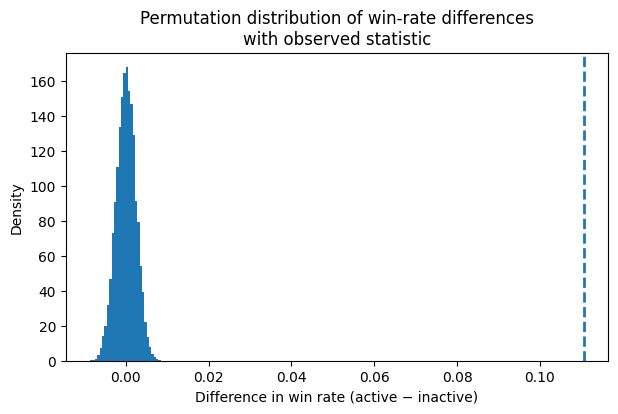

In [111]:
plt.figure(figsize=(7, 4))
plt.hist(diffs, bins=30, density=True)
plt.axvline(obs_diff, linestyle='dashed', linewidth=2)
plt.xlabel('Difference in win rate (active − inactive)')
plt.ylabel('Density')
plt.title('Permutation distribution of win-rate differences\nwith observed statistic')
plt.show()


None of the 10000 permutated test statistics were as large as the observed difference in win rates. The computed p-value from the permutation distribution was return as 0.0.

Because p-values cannot be exactly zero, we can say: p < 1/10000 = 0.0001

At the α = 0.10 significance level, the p-value from the permutation test was less than 0.0001. Since p < α, we reject the null hypothesis. The data provides strong statistical evidence that teams whose jungler participates in at least one early kill or assist are more likely to win the game compared to teams whose jungler is inactive during the early game.

# Prediction Problem

Can we predict whether a team will win the game using only early gaem information available by the 10-minute mark?